## Import the code 
All the code are in the `analysis.py`

In [13]:
%load_ext autoreload
%autoreload 2

import analysis
import pandas as pd
from matplotlib import pyplot as plt

# Use the top-1000 dataset to train; Use the epoch 80 to inference 991 cows. 
trainDirPath='/data/gpueval/imageProcessing/peguo0/cowFace/data/cropped/cowId.faceBennett.20200401-20200731.color_top1000/train'
datasetFn="cowId.faceBennett.20200801-20200821.fv" # Use Epoch 80 to get this feature vector.

# Use the test 10 dataset to train; Use the epoch 333 to inference 991 cows.
trainDirPath='/data/gpueval/imageProcessing/peguo0/cowFace/data/cropped/cowId.faceBennett.20200401-20200821.test-10/train'
datasetFn="cowId.faceBennett.20200801-20200821_model_test-10.fv" # Use Epoch 333 to get this feature vector.

# Use the top 100 dataset to train; Use the epoch 800 to inference 991 cows.
trainDirPath='/data/gpueval/imageProcessing/peguo0/cowFace/data/cropped/cowId.faceBennett.20200401-20200731.color_top100/train'
datasetFn="cowId.faceBennett.20200801-20200821_model_top100.fv" # Use Epoch 800 to get this feature vector.

# Trained with 500 cows, that quick learning curve happened again. 
# Trained with 300 cows, that quick learning curve happened again. 

# Use the top 100 dataset to train; Use the epoch 800 to inference the 'top 100 in training' cows.
trainDirPath='/data/gpueval/imageProcessing/peguo0/cowFace/data/cropped/cowId.faceBennett.20200401-20200731.color_top100/train'
datasetFn="cowId.faceBennett.20200801-20200821_model_top100_top100InTraining.fv" # Use Epoch 800 to get this feature vector.

# Trained with 200 cows, nice learning curve; Use epoch 300 to inference the 'top 100 in the training' cows. 

# Use the top 1000 dataset to train; Use the epoch 120 to inference all cows(991 cows) during 20200801-20200821.
trainDirPath='/data/gpueval/imageProcessing/peguo0/cowFace/data/cropped/cowId.faceBennett.20200401-20200731.color_top1000/train'
datasetFn="cowId.faceBennett.20200801-20200821_model_1000_epoch120.fv" # Use Epoch 120 to get this feature vector.


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Summary of the training set

Training data cover 4 months, from 1 April to 31 July 2020

Number of cow: 900
Quantile at [0, 0.25, 0.5, 0.75, 1]
[ 25.  45.  66.  76. 152.]
Total number of images: 55649



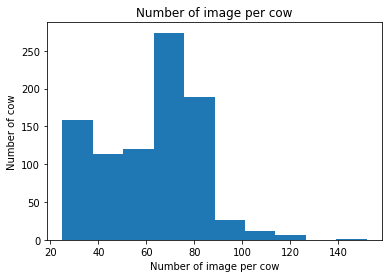

In [14]:
(trainCows,_) = analysis.summaryData(trainDirPath)

## Load our test data:



In [15]:
eidDict,dfDict=analysis.loadFv(datasetFn) 

## Compare to our test dataset


In [16]:
testCows=list(dict.fromkeys(dfDict['eids']))
print("Number of cow in Test: {}".format(len(testCows)))

common=[]
newCow=[]
for cow in testCows:
    if cow in trainCows:
        common.append(cow)
    else:
        newCow.append(cow)
print("Test cow in training set: {}".format(len(common)))
print("New cow: {}".format(len(newCow)))
print("Number of images: {}".format(len(dfDict['paths'])))


Number of cow in Test: 991
Test cow in training set: 702
New cow: 289
Number of images: 13380


# Glimpse with TSNE
* Clustering method.
* Project N dimension space into a XY plane
* Preserve neighbourhood and sacrifice long distance

### Showing the top (most image per cow) cluster :

In [17]:
numTopCow=20
eidTop,fvTop=analysis.selectTopCow(eidDict,numTopCow)

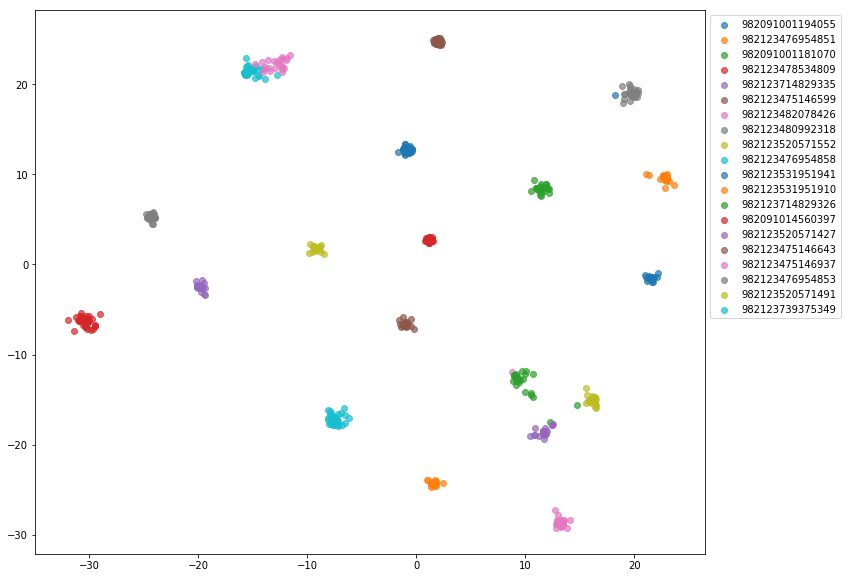

In [18]:
analysis.plotTSNE(eidTop,fvTop)

## Which are the similar cows ??

We want to see for the close clusters, how similar are those cow ??

In [19]:
data=analysis.computeClusterCentroid(eidDict)
d2Table=analysis.computeDistancePairs(data)

100%|█████████▉| 490545/491040.5 [00:05<00:00, 92156.41it/s]


In [20]:
d2Table.head()

,d2,cowA,cowB
0,1.392236,982091012162172,982123553042084
1,1.463396,982091012162172,982123553042067
2,1.498400,982091012162172,982123476954870
3,2.144617,982091012162172,982091001181297
4,1.465572,982091012162172,982123531951889


### Looking at the top close cluster :

Sort the table by distance

In [22]:
d2Table=d2Table.sort_values(by=['d2']).reset_index(drop=True)
d2Table['index'] = d2Table.index

The worst cluster distance

In [23]:
numTop=10
d2Table.head(numTop)
#w.plot(x='index',y='d2',kind='scatter')

,d2,cowA,cowB,index
0,0.090666,982123553042254,982123714450247,0
1,0.091234,982123714450213,982123714450270,1
2,0.109287,982123553042245,982123714450304,2
3,0.110044,982123714450261,982123714450304,3
4,0.111547,982123714450210,982123714450283,4
5,0.111738,982123714450265,982123714450223,5
6,0.121572,982123553042243,982123714450304,6
7,0.123970,982123714450265,982123553042226,7
8,0.125404,982123520571475,982123714829365,8
9,0.129409,982123553042243,982123553042213,9


### TSNE of the top 10 close cluster

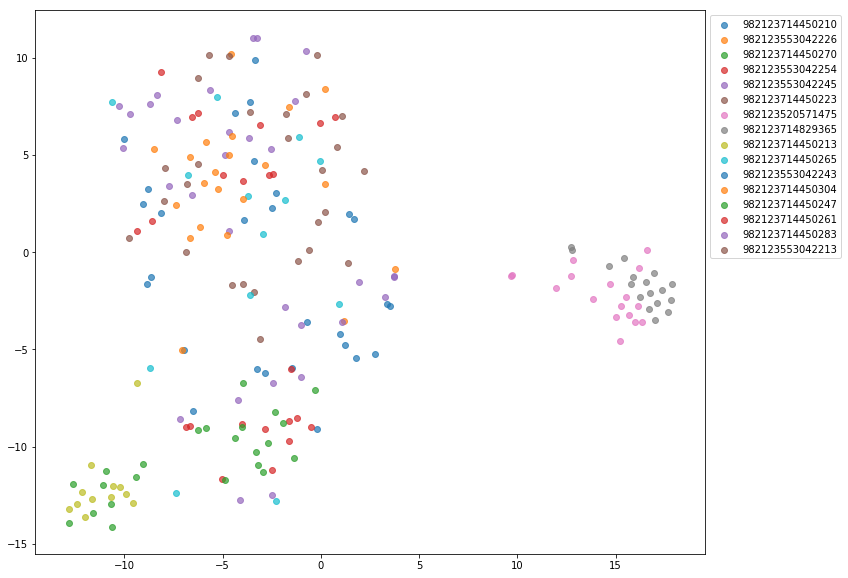

In [24]:
num=10
worstDf,eidBad,fvBad=analysis.plotWorstCluster(eidDict,d2Table,num)

In [25]:
worstDf

,d2,cowA,cowB,index
0,0.090666,982123553042254,982123714450247,0
1,0.091234,982123714450213,982123714450270,1
2,0.109287,982123553042245,982123714450304,2
3,0.110044,982123714450261,982123714450304,3
4,0.111547,982123714450210,982123714450283,4
5,0.111738,982123714450265,982123714450223,5
6,0.121572,982123553042243,982123714450304,6
7,0.123970,982123714450265,982123553042226,7
8,0.125404,982123520571475,982123714829365,8
9,0.129409,982123553042243,982123553042213,9


/data/gpueval/imageProcessing/peguo0/cowFace/analysis/worstCluster.png generated


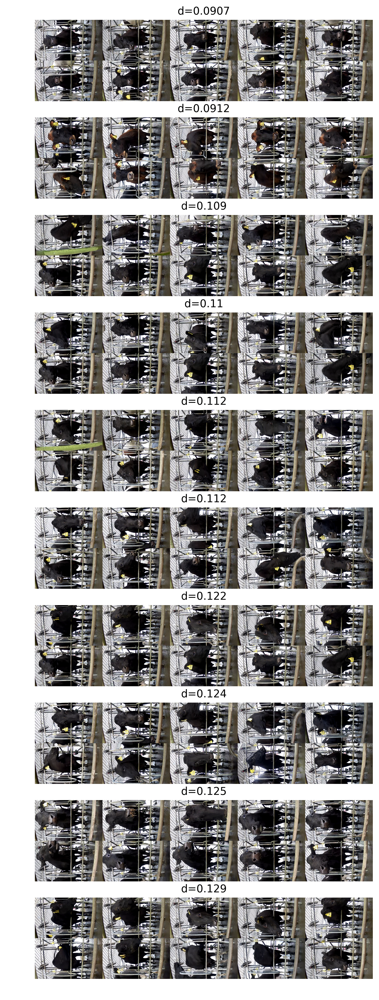

In [26]:
analysis.showWorstPairsHori(eidDict,worstDf)